In [1]:
pip install numpy pandas scikit-learn tensorflow keras shap lime matplotlib

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, Concatenate, Attention, Conv1D, LSTM, GRU, Add, LayerNormalization, GlobalAveragePooling1D
from tensorflow.keras.utils import to_categorical
import shap
import lime
from lime.lime_tabular import LimeTabularExplainer
import matplotlib.pyplot as plt

In [3]:
# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = to_categorical(y_train)
y_test_categorical = to_categorical(y_test)

In [4]:
# Hybrid Self-Attention Neural Network (H-SNN) architecture
def build_hsenn(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    attention_output = Attention()([x, x])
    x = Add()([x, attention_output])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='H-SENN')
    return model

# Adaptive Autoencoder (AAE) architecture
def build_axe(input_shape):
    inputs = Input(shape=input_shape)
    encoder = Dense(128, activation='relu')(inputs)
    encoder = Dropout(0.3)(encoder)
    encoder = Dense(64, activation='relu')(encoder)
    decoder = Dense(128, activation='relu')(encoder)
    decoder = Dropout(0.3)(decoder)
    decoder = Dense(input_shape[0], activation='sigmoid')(decoder)
    model = Model(inputs, decoder, name='AXAE')
    return model

# Ensemble Learning with Feature Attribution (ELFA)
class ExplainableEnsemble:
    def __init__(self, models):
        self.models = models

    def predict(self, X):
        predictions = [model.predict(X) for model in self.models]
        return np.mean(predictions, axis=0)

    def explain(self, X, feature_names):
        explainer = LimeTabularExplainer(
            X, feature_names=feature_names, verbose=True, mode='classification'
        )
        return explainer

In [5]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Attention, Add, Reshape, Flatten
from tensorflow.keras.models import Model
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.utils import to_categorical
import pandas as pd
import numpy as np

# Capsule Layer implementation
class CapsuleLayer(tf.keras.layers.Layer):
    def __init__(self, num_capsules, capsule_dim, num_routing=3, **kwargs):
        super(CapsuleLayer, self).__init__(**kwargs)
        self.num_capsules = num_capsules
        self.capsule_dim = capsule_dim
        self.num_routing = num_routing

    def build(self, input_shape):
        self.kernel = self.add_weight(
            shape=(input_shape[-1], self.num_capsules * self.capsule_dim),
            initializer="glorot_uniform",
            trainable=True,
        )

    def call(self, inputs):
        # Linear transformation
        u_hat = tf.einsum("bij,jk->bik", inputs, self.kernel)
        u_hat = tf.reshape(u_hat, (-1, inputs.shape[1], self.num_capsules, self.capsule_dim))

        # Routing by agreement
        b = tf.zeros_like(u_hat[:, :, :, 0])  # Initialize routing logits
        for i in range(self.num_routing):
            c = tf.nn.softmax(b, axis=2)  # Compute routing weights
            s = tf.reduce_sum(c[:, :, :, tf.newaxis] * u_hat, axis=2)  # Weighted sum
            v = self.squash(s)  # Non-linear activation
            b += tf.reduce_sum(u_hat * v[:, :, tf.newaxis, :], axis=-1)  # Update logits

        return v

    def squash(self, s):
        # Squash function to normalize capsule outputs
        norm = tf.norm(s, axis=-1, keepdims=True)
        return (norm**2 / (1 + norm**2)) * (s / (norm + tf.keras.backend.epsilon()))

# AG-XCaps Model with Capsule Layer
def build_agxcaps(input_shape):
    inputs = Input(shape=input_shape)

    # Dense and Attention Layers
    x = Dense(128, activation='relu')(inputs)
    attention = Attention()([x, x])
    x = Add()([x, attention])
    x = Dense(64, activation='relu')(x)

    # Reshape for Capsule Input
    x = tf.expand_dims(x, axis=2)

    # Capsule Layer
    capsules = CapsuleLayer(num_capsules=8, capsule_dim=16)(x)

    # Flatten Capsule Output
    capsules_flatten = Flatten()(capsules)

    # Final Classification Layer
    outputs = Dense(2, activation='softmax')(capsules_flatten)

    model = Model(inputs, outputs, name='AG-XCaps')
    return model

In [6]:
# Instantiate and train individual models
input_shape = (X_train_scaled.shape[1],)
hsenn = build_hsenn(input_shape)
axe = build_axe(input_shape)
agxcaps = build_agxcaps(input_shape)

# Compile and train models
for model in [agxcaps,hsenn]:  
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    model.fit(X_train_scaled, y_train_categorical, epochs=10, batch_size=32, validation_split=0.2, verbose=1)

Epoch 1/10
2000/2000 [==============================] - 20s 9ms/step - loss: 0.1776 - accuracy: 0.9509 - val_loss: 0.1593 - val_accuracy: 0.9514
Epoch 2/10
2000/2000 [==============================] - 19s 10ms/step - loss: 0.1494 - accuracy: 0.9520 - val_loss: 0.1496 - val_accuracy: 0.9522
Epoch 3/10
2000/2000 [==============================] - 19s 9ms/step - loss: 0.1431 - accuracy: 0.9522 - val_loss: 0.1434 - val_accuracy: 0.9524
Epoch 4/10
2000/2000 [==============================] - 20s 10ms/step - loss: 0.1401 - accuracy: 0.9526 - val_loss: 0.1417 - val_accuracy: 0.9523
Epoch 5/10
2000/2000 [==============================] - 20s 10ms/step - loss: 0.1390 - accuracy: 0.9527 - val_loss: 0.1470 - val_accuracy: 0.9528
Epoch 6/10
2000/2000 [==============================] - 20s 10ms/step - loss: 0.1379 - accuracy: 0.9526 - val_loss: 0.1420 - val_accuracy: 0.9523
Epoch 7/10
2000/2000 [==============================] - 20s 10ms/step - loss: 0.1382 - accuracy: 0.9526 - val_loss: 0.1400 - v

In [7]:
# Compile and train the AAE model
axe.compile(optimizer='adam', loss='mse')
axe.fit(
    X_train_scaled, 
    X_train_scaled, 
    epochs=10, 
    batch_size=32, 
    validation_split=0.2, 
    verbose=1
)

# Reconstruct features using the trained AAE
X_train_reconstructed = axe.predict(X_train_scaled)
X_test_reconstructed = axe.predict(X_test_scaled)

# Standardize the reconstructed features (Optional, for consistency)
scaler_reconstructed = StandardScaler()
X_train_reconstructed_scaled = scaler_reconstructed.fit_transform(X_train_reconstructed)
X_test_reconstructed_scaled = scaler_reconstructed.transform(X_test_reconstructed)

# Ensure proper class distribution
unique_classes, counts = np.unique(y_train, return_counts=True)
print(f"Class distribution in training data: {dict(zip(unique_classes, counts))}")

# Train a classifier (example: Random Forest) using reconstructed features
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train_reconstructed_scaled, y_train)

# Predict on test data
y_pred = rf_classifier.predict(X_test_reconstructed_scaled)

# Evaluate the classifier using zero_division parameter
print(
    classification_report(
        y_test, 
        y_pred, 
        zero_division=1,  # Set to 1 or 0 to handle ill-defined metrics
        target_names=['Class 0', 'Class 1']  # Replace with actual class labels
    )
)


Epoch 1/10
2000/2000 [==============================] - 3s 1ms/step - loss: 0.8236 - val_loss: 0.8007
Epoch 2/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7908 - val_loss: 0.7974
Epoch 3/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7883 - val_loss: 0.7969
Epoch 4/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7869 - val_loss: 0.7964
Epoch 5/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7863 - val_loss: 0.7961
Epoch 6/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7857 - val_loss: 0.7960
Epoch 7/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7852 - val_loss: 0.7960
Epoch 8/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7849 - val_loss: 0.7960
Epoch 9/10
2000/2000 [==============================] - 2s 1ms/step - loss: 0.7848 - val_loss: 0.7954
Epoch 10/10
625/625 [==============================] - 0s 615us/step
Class distrib

In [8]:
# Ensemble the models
ensemble_model = ExplainableEnsemble([hsenn,agxcaps])

In [9]:
# Evaluate the ensemble model without feature re-construction
ensemble_predictions = ensemble_model.predict(X_test_scaled)
ensemble_labels = np.argmax(ensemble_predictions, axis=1)
print(classification_report(y_test, ensemble_labels))

625/625 [==============================] - 2s 3ms/step
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     18999
           1       0.69      0.03      0.06      1001

    accuracy                           0.95     20000
   macro avg       0.82      0.52      0.52     20000
weighted avg       0.94      0.95      0.93     20000



In [10]:
# Evaluate the ensemble model
ensemble_predictions = ensemble_model.predict(X_test_reconstructed)
ensemble_labels = np.argmax(ensemble_predictions, axis=1)
print(classification_report(y_test, ensemble_labels))

print("Class distribution in y_train:", np.bincount(y_train))
print("Class distribution in y_test:", np.bincount(y_test))

625/625 [==============================] - 2s 4ms/step
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     18999
           1       0.00      0.00      0.00      1001

    accuracy                           0.95     20000
   macro avg       0.47      0.50      0.49     20000
weighted avg       0.90      0.95      0.93     20000

Class distribution in y_train: [76071  3929]
Class distribution in y_test: [18999  1001]


Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


In [11]:
# Ensure the data is scaled and clean
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_reconstructed)
X_test_scaled = scaler.transform(X_test_reconstructed)

# Initialize LIME Tabular Explainer
explainer = ensemble_model.explain(X_train_scaled, features)

# Explain instances with a batch predict function
for i in range(5):
    exp = explainer.explain_instance(X_test_scaled[i], lambda x: ensemble_model.predict(x))
    exp.show_in_notebook(show_table=True)


157/157 [==============================] - 1s 4ms/step
Intercept -0.0036800557477506164
Prediction_local [0.0504334]
Right: 0.030620754


157/157 [==============================] - 1s 4ms/step
Intercept 0.015703181333217773
Prediction_local [-0.00121094]
Right: 9.411011e-05


157/157 [==============================] - 1s 4ms/step
Intercept 0.014895062336260288
Prediction_local [0.02396432]
Right: 0.0012988118


157/157 [==============================] - 1s 4ms/step
Intercept 0.0008827077320686071
Prediction_local [0.04562781]
Right: 0.010847836


157/157 [==============================] - 1s 4ms/step
Intercept -0.00857286139266258
Prediction_local [0.05380048]
Right: 0.16598094


# Algorithm Main - 1

In [14]:
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import classification_report
import numpy as np
from lime.lime_tabular import LimeTabularExplainer

# Define ResNet model architecture
def build_resnet(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    x = Dense(128, activation='relu')(x)
    x_residual = Dense(128)(x)
    x = Add()([x, x_residual])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='ResNet')
    return model

# Build individual models
input_shape = (X_train_scaled.shape[1],)
hsenn = build_hsenn(input_shape)
agxcaps = build_agxcaps(input_shape)
resnet = build_resnet(input_shape)

# Compile individual models
models = [hsenn, agxcaps, resnet]
for model in models:
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
    model.fit(X_train_scaled, y_train_categorical, epochs=10, batch_size=32, validation_split=0.2, verbose=1)

# Ensemble model predictions
class EnsembleModel:
    def __init__(self, models):
        self.models = models

    def predict(self, X):
        # Average the predictions from all models
        predictions = [model.predict(X) for model in self.models]
        return np.mean(predictions, axis=0)

# Create ensemble model instance
ensemble_model = EnsembleModel(models)

# Predict on test data
ensemble_predictions = ensemble_model.predict(X_test_scaled)
ensemble_labels = np.argmax(ensemble_predictions, axis=1)

# Evaluate ensemble model
print("Classification Report for Ensemble Model:")
print(classification_report(y_test, ensemble_labels, target_names=['Class 0', 'Class 1']))

# Apply LIME for predictions
explainer = LimeTabularExplainer(
    X_train_scaled,
    feature_names=features,
    class_names=['Class 0', 'Class 1'],
    discretize_continuous=True
)

# Explain predictions for first 5 samples
for i in range(5):
    exp = explainer.explain_instance(
        X_test_scaled[i],
        lambda x: ensemble_model.predict(x),
        num_features=10
    )
    exp.show_in_notebook(show_table=True)

print("LIME explanations generated.")

Epoch 1/10
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1780 - accuracy: 0.9489 - val_loss: 0.1598 - val_accuracy: 0.9518
Epoch 2/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1574 - accuracy: 0.9509 - val_loss: 0.1592 - val_accuracy: 0.9513
Epoch 3/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1540 - accuracy: 0.9511 - val_loss: 0.1571 - val_accuracy: 0.9498
Epoch 4/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1525 - accuracy: 0.9513 - val_loss: 0.1629 - val_accuracy: 0.9518
Epoch 5/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1518 - accuracy: 0.9510 - val_loss: 0.1573 - val_accuracy: 0.9521
Epoch 6/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1523 - accuracy: 0.9510 - val_loss: 0.1543 - val_accuracy: 0.9524
Epoch 7/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1505 - accuracy: 0.9512 - val_loss: 0.1604 - val_accuracy:

157/157 [==============================] - 0s 853us/step


157/157 [==============================] - 0s 827us/step


157/157 [==============================] - 0s 846us/step


157/157 [==============================] - 0s 827us/step


LIME explanations generated.


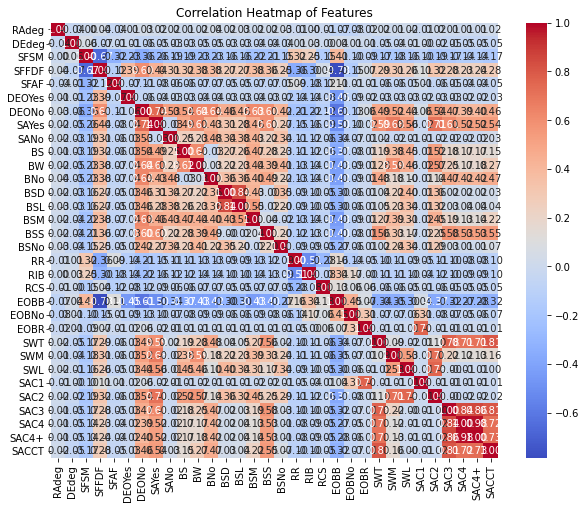

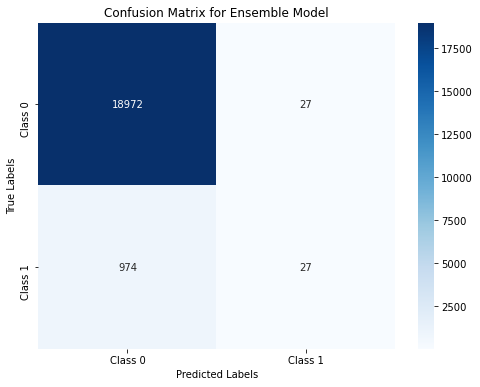

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Compute correlation matrix for the features
correlation_matrix = np.corrcoef(X_train_scaled.T)

# Plot correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', xticklabels=features, yticklabels=features)
plt.title("Correlation Heatmap of Features")
plt.show()

# Compute confusion matrix
conf_matrix = confusion_matrix(y_test, ensemble_labels)

# Plot confusion matrix heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.title("Confusion Matrix for Ensemble Model")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

# Algorithm Main - 2

In [16]:
from tensorflow.keras.layers import GRU, Reshape

# Define ResNet model architecture with GRU layers
def build_resnet_with_gru(input_shape):
    inputs = Input(shape=input_shape)
    
    # Dense layers for initial feature extraction
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    x = Dense(128, activation='relu')(x)
    
    # Adding a GRU layer for sequential modeling
    x_reshaped = Reshape((-1, 128))(x)  # Reshape to (batch_size, time_steps, features)
    x_gru = GRU(64, return_sequences=True)(x_reshaped)  # GRU layer with 64 units
    x_gru = GRU(64)(x_gru)  # Second GRU layer to further refine sequential dependencies
    
    # Adding a residual connection and normalization
    x_residual = Dense(64)(x_gru)
    x = Add()([x_gru, x_residual])
    x = LayerNormalization()(x)
    
    # Final dense layers for classification
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    
    model = Model(inputs, outputs, name='ResNet_with_GRU')
    return model

# Build individual models with the new ResNet_with_GRU
resnet_with_gru = build_resnet_with_gru(input_shape)

# Add the updated ResNet with GRU to the list of models
models = [hsenn, agxcaps, resnet_with_gru]

# Compile individual models
for model in models:
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
    model.fit(X_train_scaled, y_train_categorical, epochs=10, batch_size=32, validation_split=0.2, verbose=1)

# Ensemble model remains unchanged
ensemble_model = EnsembleModel(models)

# Predict on test data and evaluate
ensemble_predictions = ensemble_model.predict(X_test_scaled)
ensemble_labels = np.argmax(ensemble_predictions, axis=1)

print("Classification Report for Ensemble Model with GRU-enhanced ResNet:")
print(classification_report(y_test, ensemble_labels, target_names=['Class 0', 'Class 1']))

# Apply LIME for predictions (unchanged)
explainer = LimeTabularExplainer(
    X_train_scaled,
    feature_names=features,
    class_names=['Class 0', 'Class 1'],
    discretize_continuous=True
)

for i in range(5):
    exp = explainer.explain_instance(
        X_test_scaled[i],
        lambda x: ensemble_model.predict(x),
        num_features=10
    )
    exp.show_in_notebook(show_table=True)

print("LIME explanations generated.")

Epoch 1/10
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1503 - accuracy: 0.9514 - val_loss: 0.1551 - val_accuracy: 0.9525
Epoch 2/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1500 - accuracy: 0.9514 - val_loss: 0.1521 - val_accuracy: 0.9523
Epoch 3/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1492 - accuracy: 0.9516 - val_loss: 0.1545 - val_accuracy: 0.9524
Epoch 4/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1495 - accuracy: 0.9514 - val_loss: 0.1524 - val_accuracy: 0.9516
Epoch 5/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1491 - accuracy: 0.9514 - val_loss: 0.1534 - val_accuracy: 0.9524
Epoch 6/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1498 - accuracy: 0.9515 - val_loss: 0.1557 - val_accuracy: 0.9517
Epoch 7/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1490 - accuracy: 0.9514 - val_loss: 0.1564 - val_accuracy:

157/157 [==============================] - 0s 1ms/step


157/157 [==============================] - 0s 1ms/step


157/157 [==============================] - 0s 1ms/step


157/157 [==============================] - 0s 1ms/step


LIME explanations generated.


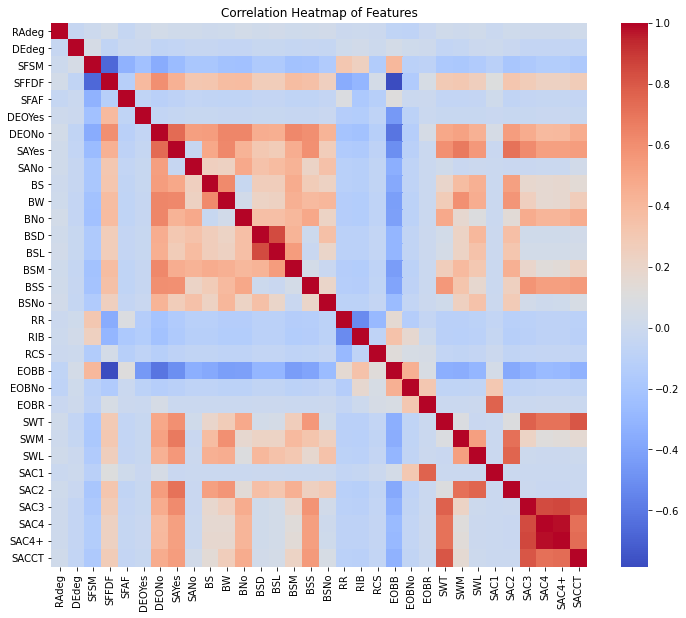

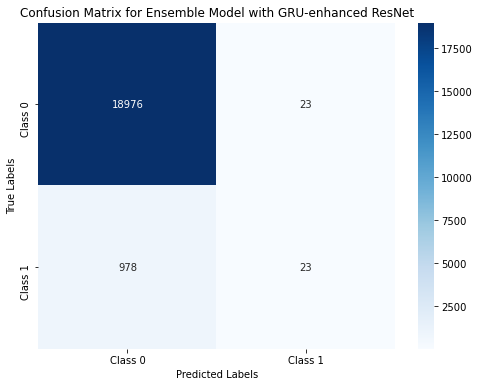

In [17]:
# Ensure all necessary imports and libraries are included
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Calculate the correlation matrix for the features
correlation_matrix = np.corrcoef(X_train_scaled.T)

# Plot correlation heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', xticklabels=features, yticklabels=features)
plt.title("Correlation Heatmap of Features")
plt.show()

# Compute confusion matrix for the ensemble model predictions
conf_matrix = confusion_matrix(y_test, ensemble_labels)

# Plot confusion matrix heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.title("Confusion Matrix for Ensemble Model with GRU-enhanced ResNet")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()

In [18]:
# import pandas as pd

# # Assuming df is your DataFrame with the columns MNo, MMiD, MMaD, MM

# # Define the merger activity column
# df['MergerActivity'] = ((df['MMiD'] > 0.5) | (df['MMaD'] > 0.5) | (df['MM'] > 0.5)).astype(int)



4/4 [==============================] - 0s 2ms/step


  0%|          | 0/10 [00:00<?, ?it/s]

6594/6594 [==============================] - 8s 1ms/step


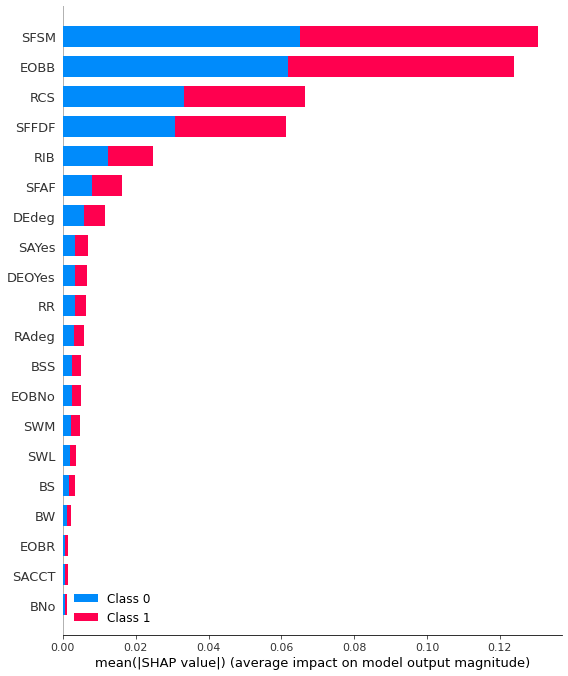

In [19]:
# SHAP Explainable AI predictions
import shap

# Create SHAP explainer
explainer = shap.KernelExplainer(ensemble_model.predict, X_train_scaled[:100])

# Explain predictions for a subset of the test data
shap_values = explainer.shap_values(X_test_scaled[:10])

# Visualize SHAP summary plot
shap.summary_plot(shap_values, X_test_scaled, feature_names=features)

# Visualize SHAP individual force plots for specific samples
for i in range(5):
    shap.force_plot(
        explainer.expected_value[0], 
        shap_values[0][i], 
        X_test_scaled[i], 
        feature_names=features
    )

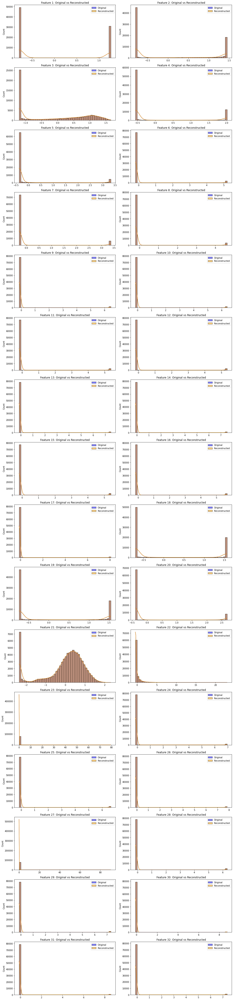

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns
import math

# Get the number of features
num_features = X_train_scaled.shape[1]

# Determine the number of rows and columns for the subplots
n_cols = 2  
n_rows = math.ceil(num_features / n_cols)  

# Create subplots
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, n_rows * 4))

# Flatten axes for easy iteration
axes = axes.flatten()

# Plot distributions for each feature
for i in range(num_features):
    sns.histplot(X_train_scaled[:, i], bins=50, kde=True, ax=axes[i], color='blue', label='Original')
    sns.histplot(X_train_reconstructed_scaled[:, i], bins=50, kde=True, ax=axes[i], color='orange', label='Reconstructed')
    axes[i].set_title(f"Feature {i+1}: Original vs Reconstructed")
    axes[i].legend()

# Remove unused subplots if the number of features is less than rows * cols
for j in range(num_features, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

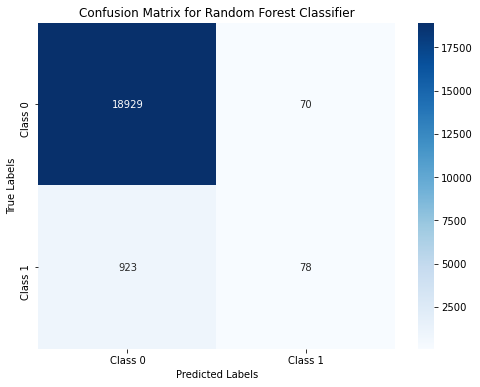

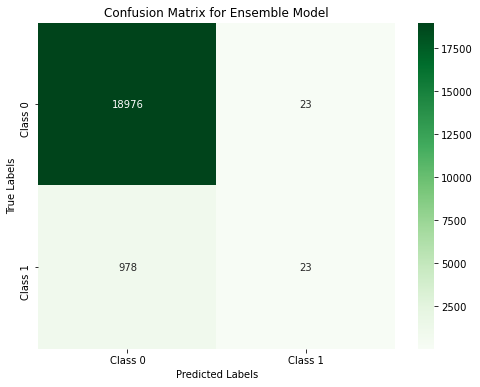

In [21]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

# Confusion matrix for Random Forest Classifier
rf_cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(rf_cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.title('Confusion Matrix for Random Forest Classifier')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Confusion matrix for Ensemble Model
ensemble_cm = confusion_matrix(y_test, ensemble_labels)
plt.figure(figsize=(8, 6))
sns.heatmap(ensemble_cm, annot=True, fmt='d', cmap='Greens', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
plt.title('Confusion Matrix for Ensemble Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

Epoch 1/10
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1487 - accuracy: 0.9515 - val_loss: 0.1538 - val_accuracy: 0.9523
Epoch 2/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1479 - accuracy: 0.9516 - val_loss: 0.1576 - val_accuracy: 0.9521
Epoch 3/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1480 - accuracy: 0.9518 - val_loss: 0.1584 - val_accuracy: 0.9524
Epoch 4/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1481 - accuracy: 0.9517 - val_loss: 0.1555 - val_accuracy: 0.9524
Epoch 5/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1480 - accuracy: 0.9515 - val_loss: 0.1545 - val_accuracy: 0.9521
Epoch 6/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1475 - accuracy: 0.9513 - val_loss: 0.1526 - val_accuracy: 0.9523
Epoch 7/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1475 - accuracy: 0.9515 - val_loss: 0.1564 - val_accuracy:

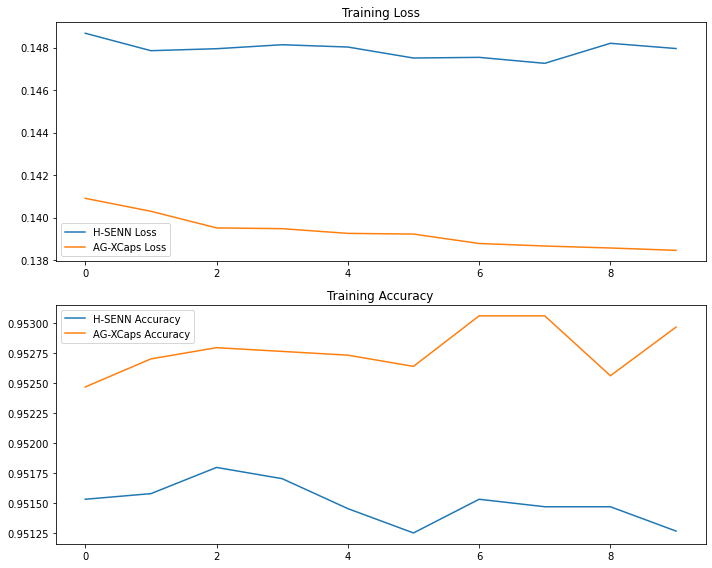

In [23]:
# 3. Model Loss and Accuracy (Training)

import matplotlib.pyplot as plt
import numpy as np

# Train the H-SENN model
hsenn.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
hsenn_history = hsenn.fit(
    X_train_scaled, y_train_categorical,
    validation_split=0.2,
    epochs=10,
    batch_size=32,
    verbose=1
)

# Train the AG-XCaps model
agxcaps.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
agxcaps_history = agxcaps.fit(
    X_train_scaled, y_train_categorical,
    validation_split=0.2,
    epochs=10,
    batch_size=32,
    verbose=1
)

# Plot training loss and accuracy
fig, axes = plt.subplots(2, 1, figsize=(10, 8))

# Plot training loss
axes[0].plot(hsenn_history.history['loss'], label='H-SENN Loss')
axes[0].plot(agxcaps_history.history['loss'], label='AG-XCaps Loss')
axes[0].set_title("Training Loss")
axes[0].legend()

# Plot training accuracy
axes[1].plot(hsenn_history.history['accuracy'], label='H-SENN Accuracy')
axes[1].plot(agxcaps_history.history['accuracy'], label='AG-XCaps Accuracy')
axes[1].set_title("Training Accuracy")
axes[1].legend()

plt.tight_layout()
plt.show()


Epoch 1/10
2000/2000 [==============================] - 9s 3ms/step - loss: 0.1657 - accuracy: 0.9506 - val_loss: 0.1537 - val_accuracy: 0.9513
Epoch 2/10
2000/2000 [==============================] - 5s 3ms/step - loss: 0.1557 - accuracy: 0.9508 - val_loss: 0.1538 - val_accuracy: 0.9513
Epoch 3/10
2000/2000 [==============================] - 5s 3ms/step - loss: 0.1541 - accuracy: 0.9510 - val_loss: 0.1548 - val_accuracy: 0.9513
Epoch 4/10
2000/2000 [==============================] - 5s 3ms/step - loss: 0.1521 - accuracy: 0.9509 - val_loss: 0.1517 - val_accuracy: 0.9513
Epoch 5/10
2000/2000 [==============================] - 6s 3ms/step - loss: 0.1509 - accuracy: 0.9509 - val_loss: 0.1571 - val_accuracy: 0.9513
Epoch 6/10
2000/2000 [==============================] - 6s 3ms/step - loss: 0.1505 - accuracy: 0.9510 - val_loss: 0.1525 - val_accuracy: 0.9517
Epoch 7/10
2000/2000 [==============================] - 5s 3ms/step - loss: 0.1499 - accuracy: 0.9508 - val_loss: 0.1518 - val_accuracy:

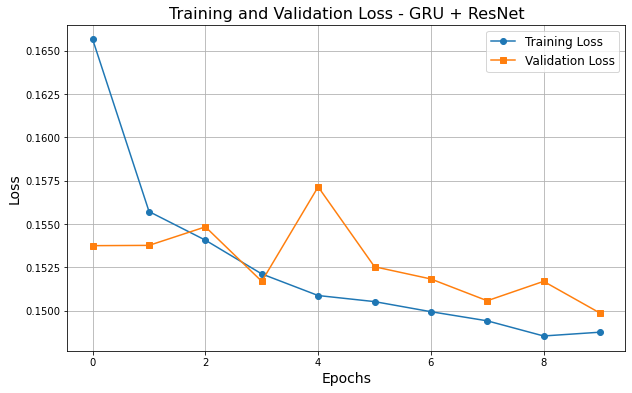

In [24]:
import matplotlib.pyplot as plt

# Train the GRU + ResNet model and store the history
resnet_with_gru = build_resnet_with_gru(input_shape)
resnet_with_gru.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

history_gru_resnet = resnet_with_gru.fit(
    X_train_scaled, 
    y_train_categorical, 
    epochs=10, 
    batch_size=32, 
    validation_split=0.2, 
    verbose=1
)

# Plot training and validation losses
plt.figure(figsize=(10, 6))
plt.plot(history_gru_resnet.history['loss'], label='Training Loss', marker='o')
plt.plot(history_gru_resnet.history['val_loss'], label='Validation Loss', marker='s')
plt.title('Training and Validation Loss - GRU + ResNet', fontsize=16)
plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Loss', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True)
plt.show()

Epoch 1/10
2000/2000 [==============================] - 5s 2ms/step - loss: 0.1672 - accuracy: 0.9504 - val_loss: 0.1540 - val_accuracy: 0.9513
Epoch 2/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1556 - accuracy: 0.9508 - val_loss: 0.1535 - val_accuracy: 0.9520
Epoch 3/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1533 - accuracy: 0.9509 - val_loss: 0.1555 - val_accuracy: 0.9513
Epoch 4/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1521 - accuracy: 0.9510 - val_loss: 0.1525 - val_accuracy: 0.9516
Epoch 5/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1516 - accuracy: 0.9511 - val_loss: 0.1495 - val_accuracy: 0.9513
Epoch 6/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1499 - accuracy: 0.9510 - val_loss: 0.1511 - val_accuracy: 0.9513
Epoch 7/10
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1489 - accuracy: 0.9513 - val_loss: 0.1492 - val_accuracy:

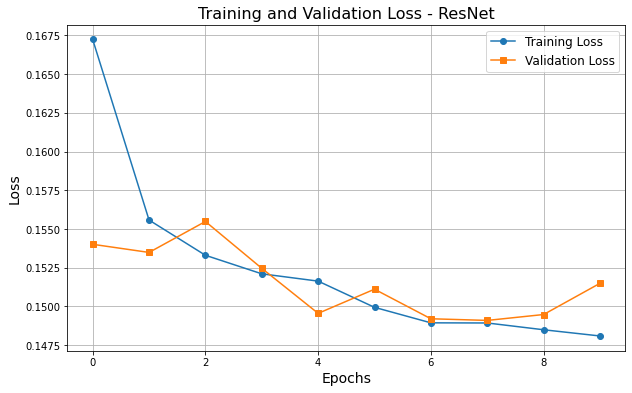

In [25]:
# Train the ResNet model and store the history
resnet = build_resnet(input_shape)
resnet.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

history_resnet = resnet.fit(
    X_train_scaled, 
    y_train_categorical, 
    epochs=10, 
    batch_size=32, 
    validation_split=0.2, 
    verbose=1
)

# Plot training and validation losses
plt.figure(figsize=(10, 6))
plt.plot(history_resnet.history['loss'], label='Training Loss', marker='o')
plt.plot(history_resnet.history['val_loss'], label='Validation Loss', marker='s')
plt.title('Training and Validation Loss - ResNet', fontsize=16)
plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Loss', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True)
plt.show()

# Ablation Study of the Proposed Algorithm

Epoch 1/5
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1615 - accuracy: 0.9506 - val_loss: 0.1426 - val_accuracy: 0.9521
Epoch 2/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1438 - accuracy: 0.9517 - val_loss: 0.1408 - val_accuracy: 0.9525
Epoch 3/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1409 - accuracy: 0.9522 - val_loss: 0.1386 - val_accuracy: 0.9524
Epoch 4/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1394 - accuracy: 0.9525 - val_loss: 0.1364 - val_accuracy: 0.9529
Epoch 5/5
2000/2000 [==============================] - 2s 1ms/step - loss: 0.1374 - accuracy: 0.9522 - val_loss: 0.1385 - val_accuracy: 0.9523
Epoch 1/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.2164 - accuracy: 0.9478 - val_loss: 0.1832 - val_accuracy: 0.9513
Epoch 2/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1758 - accuracy: 0.9508 - val_loss: 0.1683 - val_accuracy: 0.9513

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


625/625 [==============================] - 1s 758us/step

Classification Report for H-SENN_wo_LayerNorm:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     18999
           1       0.76      0.03      0.06      1001

    accuracy                           0.95     20000
   macro avg       0.85      0.52      0.52     20000
weighted avg       0.94      0.95      0.93     20000

625/625 [==============================] - 1s 890us/step

Classification Report for H-SENN_wo_Dropout:
              precision    recall  f1-score   support

           0       0.95      1.00      0.97     18999
           1       0.53      0.03      0.06      1001

    accuracy                           0.95     20000
   macro avg       0.74      0.51      0.52     20000
weighted avg       0.93      0.95      0.93     20000

625/625 [==============================] - 1s 936us/step


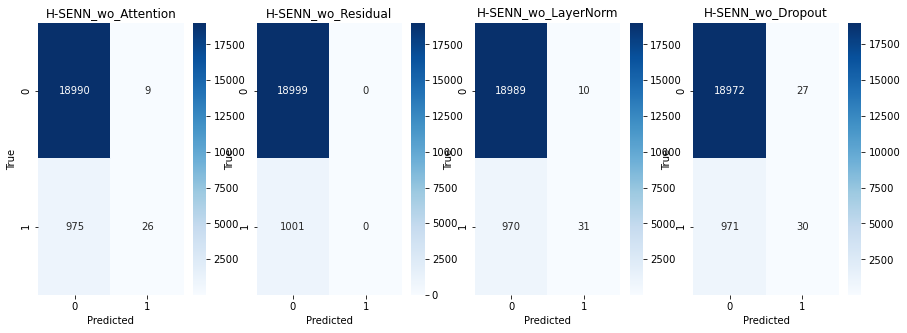

4/4 [==============================] - 0s 1ms/step


  0%|          | 0/10 [00:00<?, ?it/s]

6582/6582 [==============================] - 5s 726us/step


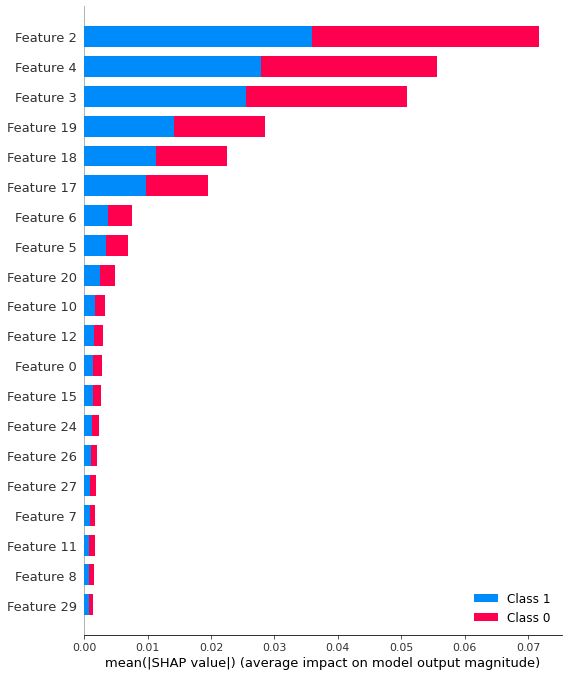

In [30]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, Add, LayerNormalization, Flatten, Reshape, GRU, Conv1D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from lime.lime_tabular import LimeTabularExplainer

# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = tf.keras.utils.to_categorical(y_train, 2)
y_test_categorical = tf.keras.utils.to_categorical(y_test, 2)

# Ablation Study: Define variations of H-SNN architecture

def build_hsenn_without_attention(input_shape):
    """ H-SNN without Attention Layer """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='H-SENN_wo_Attention')
    return model

def build_hsenn_without_residual(input_shape):
    """ H-SNN without Residual Connections """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    attention_output = Attention()([x, x])
    x = Dense(64, activation='relu')(attention_output)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='H-SENN_wo_Residual')
    return model

def build_hsenn_without_layernorm(input_shape):
    """ H-SNN without Layer Normalization """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    attention_output = Attention()([x, x])
    x = Add()([x, attention_output])
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='H-SENN_wo_LayerNorm')
    return model

def build_hsenn_without_dropout(input_shape):
    """ H-SNN without Dropout Layers """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    attention_output = Attention()([x, x])
    x = Add()([x, attention_output])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='H-SENN_wo_Dropout')
    return model

# Train Ablation Models
models = {
    "H-SENN_wo_Attention": build_hsenn_without_attention(X_train_scaled.shape[1:]),
    "H-SENN_wo_Residual": build_hsenn_without_residual(X_train_scaled.shape[1:]),
    "H-SENN_wo_LayerNorm": build_hsenn_without_layernorm(X_train_scaled.shape[1:]),
    "H-SENN_wo_Dropout": build_hsenn_without_dropout(X_train_scaled.shape[1:])
}

histories = {}
for name, model in models.items():
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
    history = model.fit(X_train_scaled, y_train_categorical, epochs=5, batch_size=32, validation_split=0.2, verbose=1)
    histories[name] = history

# Evaluate Models
for name, model in models.items():
    predictions = np.argmax(model.predict(X_test_scaled), axis=1)
    print(f"\nClassification Report for {name}:")
    print(classification_report(y_test, predictions))

# Generate Confusion Matrices
fig, axes = plt.subplots(1, len(models), figsize=(15, 5))
for i, (name, model) in enumerate(models.items()):
    predictions = np.argmax(model.predict(X_test_scaled), axis=1)
    cm = confusion_matrix(y_test, predictions)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[i])
    axes[i].set_title(f"{name}")
    axes[i].set_xlabel("Predicted")
    axes[i].set_ylabel("True")
plt.show()

# SHAP Feature Importance Analysis
explainer = shap.KernelExplainer(models["H-SENN_wo_Attention"].predict, X_train_scaled[:100])
shap_values = explainer.shap_values(X_test_scaled[:10])
shap.summary_plot(shap_values, X_test_scaled)

Epoch 1/5
2000/2000 [==============================] - 5s 2ms/step - loss: 0.1584 - accuracy: 0.9507 - val_loss: 0.1456 - val_accuracy: 0.9523
Epoch 2/5
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1446 - accuracy: 0.9512 - val_loss: 0.1403 - val_accuracy: 0.9517
Epoch 3/5
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1410 - accuracy: 0.9523 - val_loss: 0.1380 - val_accuracy: 0.9523
Epoch 4/5
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1400 - accuracy: 0.9520 - val_loss: 0.1411 - val_accuracy: 0.9524
Epoch 5/5
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1383 - accuracy: 0.9521 - val_loss: 0.1371 - val_accuracy: 0.9528
Epoch 1/5
2000/2000 [==============================] - 9s 3ms/step - loss: 0.1574 - accuracy: 0.9508 - val_loss: 0.1462 - val_accuracy: 0.9522
Epoch 2/5
2000/2000 [==============================] - 5s 3ms/step - loss: 0.1433 - accuracy: 0.9517 - val_loss: 0.1406 - val_accuracy: 0.9526

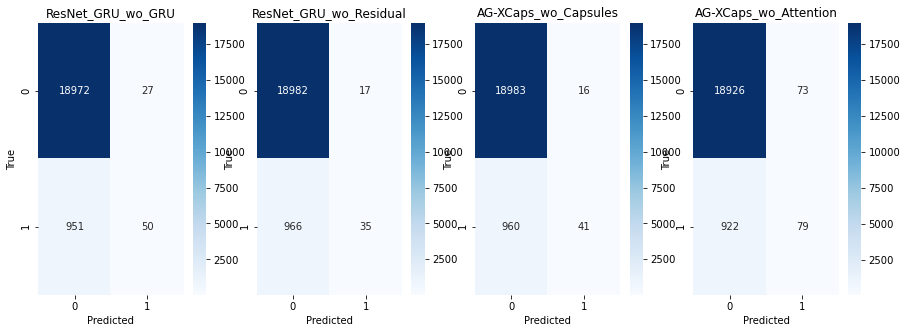

In [31]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, Add, LayerNormalization, Flatten, Reshape, GRU, Conv1D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from lime.lime_tabular import LimeTabularExplainer

# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = tf.keras.utils.to_categorical(y_train, 2)
y_test_categorical = tf.keras.utils.to_categorical(y_test, 2)

# Ablation Study: Define variations of models

def build_resnet_with_gru_without_gru(input_shape):
    """ ResNet with GRU but without GRU layers """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    x = Dense(128, activation='relu')(x)
    x_residual = Dense(128)(x)
    x = Add()([x, x_residual])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='ResNet_GRU_wo_GRU')
    return model

def build_resnet_with_gru_without_residual(input_shape):
    """ ResNet with GRU but without Residual Connections """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    x = GRU(64, return_sequences=True)(Reshape((-1, 128))(x))
    x = GRU(64)(x)
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='ResNet_GRU_wo_Residual')
    return model

def build_agxcaps_without_capsules(input_shape):
    """ AG-XCaps without Capsule Layer """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    attention = Attention()([x, x])
    x = Add()([x, attention])
    x = Dense(64, activation='relu')(x)
    x = Flatten()(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='AG-XCaps_wo_Capsules')
    return model

def build_agxcaps_without_attention(input_shape):
    """ AG-XCaps without Attention Layer """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dense(64, activation='relu')(x)
    x = Flatten()(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='AG-XCaps_wo_Attention')
    return model

# Train Ablation Models
models = {
    "ResNet_GRU_wo_GRU": build_resnet_with_gru_without_gru(X_train_scaled.shape[1:]),
    "ResNet_GRU_wo_Residual": build_resnet_with_gru_without_residual(X_train_scaled.shape[1:]),
    "AG-XCaps_wo_Capsules": build_agxcaps_without_capsules(X_train_scaled.shape[1:]),
    "AG-XCaps_wo_Attention": build_agxcaps_without_attention(X_train_scaled.shape[1:])
}

for name, model in models.items():
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
    model.fit(X_train_scaled, y_train_categorical, epochs=5, batch_size=32, validation_split=0.2, verbose=1)
    
# Evaluate Models
for name, model in models.items():
    predictions = np.argmax(model.predict(X_test_scaled), axis=1)
    print(f"\nClassification Report for {name}:")
    print(classification_report(y_test, predictions))

# Generate Confusion Matrices
fig, axes = plt.subplots(1, len(models), figsize=(15, 5))
for i, (name, model) in enumerate(models.items()):
    predictions = np.argmax(model.predict(X_test_scaled), axis=1)
    cm = confusion_matrix(y_test, predictions)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[i])
    axes[i].set_title(f"{name}")
    axes[i].set_xlabel("Predicted")
    axes[i].set_ylabel("True")
plt.show()

Epoch 1/5
2000/2000 [==============================] - 4s 2ms/step - loss: 0.1808 - accuracy: 0.9489 - val_loss: 0.1612 - val_accuracy: 0.9519
Epoch 2/5
2000/2000 [==============================] - 3s 2ms/step - loss: 0.1508 - accuracy: 0.9518 - val_loss: 0.1466 - val_accuracy: 0.9521
Epoch 3/5
2000/2000 [==============================] - 2s 1ms/step - loss: 0.1427 - accuracy: 0.9525 - val_loss: 0.1464 - val_accuracy: 0.9517
Epoch 4/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1403 - accuracy: 0.9524 - val_loss: 0.1439 - val_accuracy: 0.9518
Epoch 5/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1394 - accuracy: 0.9524 - val_loss: 0.1408 - val_accuracy: 0.9528
Epoch 1/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1498 - accuracy: 0.9517 - val_loss: 0.1405 - val_accuracy: 0.9521
Epoch 2/5
2000/2000 [==============================] - 3s 1ms/step - loss: 0.1360 - accuracy: 0.9526 - val_loss: 0.1437 - val_accuracy: 0.9501

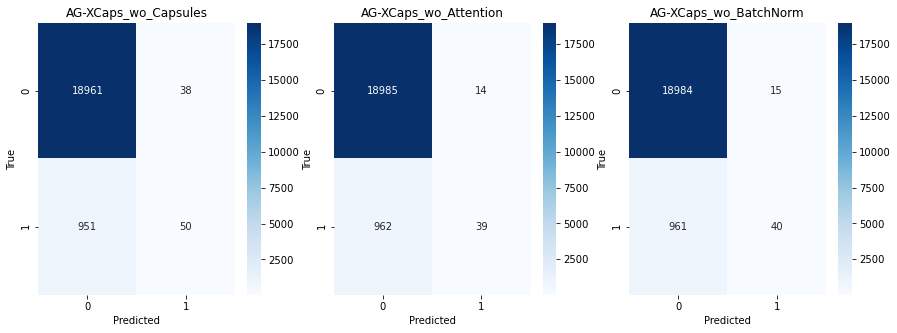

In [32]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, Add, LayerNormalization, Flatten, Reshape, GRU, Conv1D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from lime.lime_tabular import LimeTabularExplainer

# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = tf.keras.utils.to_categorical(y_train, 2)
y_test_categorical = tf.keras.utils.to_categorical(y_test, 2)

# Ablation Study: Define variations of AG-XCaps Model

def build_agxcaps_without_capsules(input_shape):
    """ AG-XCaps without Capsule Layer """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    attention = Attention()([x, x])
    x = Add()([x, attention])
    x = Dense(64, activation='relu')(x)
    x = Flatten()(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='AG-XCaps_wo_Capsules')
    return model

def build_agxcaps_without_attention(input_shape):
    """ AG-XCaps without Attention Layer """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dense(64, activation='relu')(x)
    x = Flatten()(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='AG-XCaps_wo_Attention')
    return model

def build_agxcaps_without_batchnorm(input_shape):
    """ AG-XCaps without Batch Normalization """
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = BatchNormalization()(x)
    attention = Attention()([x, x])
    x = Add()([x, attention])
    x = Dense(64, activation='relu')(x)
    x = Flatten()(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='AG-XCaps_wo_BatchNorm')
    return model

# Train Ablation Models
models = {
    "AG-XCaps_wo_Capsules": build_agxcaps_without_capsules(X_train_scaled.shape[1:]),
    "AG-XCaps_wo_Attention": build_agxcaps_without_attention(X_train_scaled.shape[1:]),
    "AG-XCaps_wo_BatchNorm": build_agxcaps_without_batchnorm(X_train_scaled.shape[1:])
}

for name, model in models.items():
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])
    model.fit(X_train_scaled, y_train_categorical, epochs=5, batch_size=32, validation_split=0.2, verbose=1)
    
# Evaluate Models
for name, model in models.items():
    predictions = np.argmax(model.predict(X_test_scaled), axis=1)
    print(f"\nClassification Report for {name}:")
    print(classification_report(y_test, predictions))

# Generate Confusion Matrices
fig, axes = plt.subplots(1, len(models), figsize=(15, 5))
for i, (name, model) in enumerate(models.items()):
    predictions = np.argmax(model.predict(X_test_scaled), axis=1)
    cm = confusion_matrix(y_test, predictions)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[i])
    axes[i].set_title(f"{name}")
    axes[i].set_xlabel("Predicted")
    axes[i].set_ylabel("True")
plt.show()


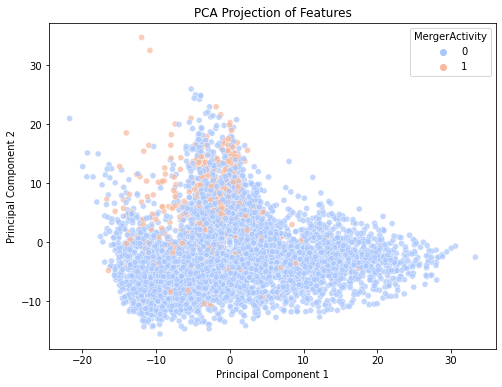

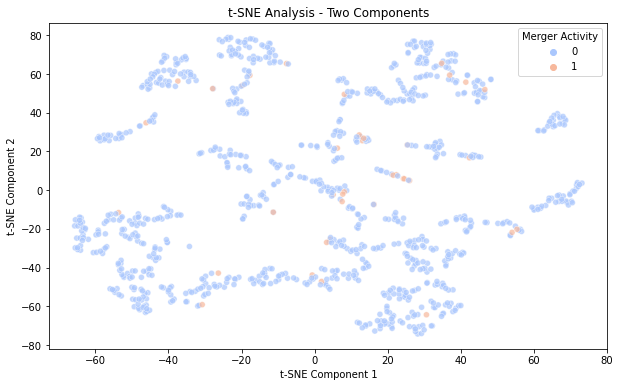

Explained Variance by First Two Principal Components: 0.1809, 0.0976


In [28]:
import numpy as np
import pandas as pd
import tensorflow as tf
import os
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, Add, LayerNormalization, Flatten, Reshape, GRU, Conv1D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from lime.lime_tabular import LimeTabularExplainer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Set environment variables to avoid OpenBLAS threading issues
os.environ["OMP_NUM_THREADS"] = "1"
os.environ["OPENBLAS_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
os.environ["VECLIB_MAXIMUM_THREADS"] = "1"
os.environ["NUMEXPR_NUM_THREADS"] = "1"

# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = tf.keras.utils.to_categorical(y_train, 2)
y_test_categorical = tf.keras.utils.to_categorical(y_test, 2)

# PCA Analysis
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_train_scaled)
plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=y_train, palette="coolwarm", alpha=0.7)
plt.title("PCA Projection of Features")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.show()

# t-SNE Analysis (Fixed with Perplexity Adjustment and Subsampling)
tsne = TSNE(n_components=2, perplexity=10, random_state=42, method='exact')
X_tsne = tsne.fit_transform(X_train_scaled[:1000])  # Subsampling to 1000 samples for better performance

# Plot t-SNE results
plt.figure(figsize=(10, 6))
sns.scatterplot(x=X_tsne[:, 0], y=X_tsne[:, 1], hue=y_train[:1000], palette='coolwarm', alpha=0.7)
plt.title("t-SNE Analysis - Two Components")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Merger Activity")
plt.show()

# Display variance explained by PCA
explained_variance = pca.explained_variance_ratio_
print(f"Explained Variance by First Two Principal Components: {explained_variance[0]:.4f}, {explained_variance[1]:.4f}")

# No. of Parameters, Model Size and Layer Wise analysis of the Proposed Model

In [29]:
import numpy as np
import pandas as pd
import tensorflow as tf
import os
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, Add, LayerNormalization, Flatten, Reshape, GRU, Conv1D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from lime.lime_tabular import LimeTabularExplainer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Set environment variables to avoid OpenBLAS threading issues
os.environ["OMP_NUM_THREADS"] = "1"
os.environ["OPENBLAS_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
os.environ["VECLIB_MAXIMUM_THREADS"] = "1"
os.environ["NUMEXPR_NUM_THREADS"] = "1"

# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = tf.keras.utils.to_categorical(y_train, 2)
y_test_categorical = tf.keras.utils.to_categorical(y_test, 2)

# Define models
def build_hsenn(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    attention_output = Attention()([x, x])
    x = Add()([x, attention_output])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='H-SENN')
    return model

def build_agxcaps(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    attention = Attention()([x, x])
    x = Add()([x, attention])
    x = Dense(64, activation='relu')(x)
    x = Flatten()(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='AG-XCaps')
    return model

def build_resnet_with_gru(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    x = Dense(128, activation='relu')(x)
    x_reshaped = Reshape((-1, 128))(x)
    x_gru = GRU(64, return_sequences=True)(x_reshaped)
    x_gru = GRU(64)(x_gru)
    x_residual = Dense(64)(x_gru)
    x = Add()([x_gru, x_residual])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='ResNet_with_GRU')
    return model

# Instantiate models
hsenn = build_hsenn(X_train_scaled.shape[1:])
agxcaps = build_agxcaps(X_train_scaled.shape[1:])
resnet_gru = build_resnet_with_gru(X_train_scaled.shape[1:])
ensemble_models = [hsenn, agxcaps, resnet_gru]

# Function to print model summary and count parameters
def model_analysis(model):
    model.summary()
    total_params = model.count_params()
    print(f"Total Parameters: {total_params}")
    return total_params

# Perform analysis for each model
params_hsenn = model_analysis(hsenn)
params_agxcaps = model_analysis(agxcaps)
params_resnet_gru = model_analysis(resnet_gru)

def calculate_model_size(model):
    total_params = model.count_params()
    size_in_bytes = total_params * 4  # Assuming 4 bytes per parameter
    size_in_mb = size_in_bytes / (1024 ** 2)
    return size_in_mb

size_hsenn = calculate_model_size(hsenn)
size_agxcaps = calculate_model_size(agxcaps)
size_resnet_gru = calculate_model_size(resnet_gru)

print(f"Model Size (MB): H-SENN: {size_hsenn:.2f}, AG-XCaps: {size_agxcaps:.2f}, ResNet-GRU: {size_resnet_gru:.2f}")


Model: "H-SENN"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_12 (InputLayer)       [(None, 32)]                 0         []                            
                                                                                                  
 dense_42 (Dense)            (None, 128)                  4224      ['input_12[0][0]']            
                                                                                                  
 dropout_16 (Dropout)        (None, 128)                  0         ['dense_42[0][0]']            
                                                                                                  
 attention_6 (Attention)     (None, 128)                  0         ['dropout_16[0][0]',          
                                                                     'dropout_16[0][0]']     

In [30]:
import numpy as np
import pandas as pd
import tensorflow as tf
import os
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, Add, LayerNormalization, Flatten, Reshape, GRU, Conv1D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from lime.lime_tabular import LimeTabularExplainer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Set environment variables to avoid OpenBLAS threading issues
os.environ["OMP_NUM_THREADS"] = "1"
os.environ["OPENBLAS_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
os.environ["VECLIB_MAXIMUM_THREADS"] = "1"
os.environ["NUMEXPR_NUM_THREADS"] = "1"

# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = tf.keras.utils.to_categorical(y_train, 2)
y_test_categorical = tf.keras.utils.to_categorical(y_test, 2)

# Define models
def build_hsenn(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    attention_output = Attention()([x, x])
    x = Add()([x, attention_output])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='H-SENN')
    return model

def build_agxcaps(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    attention = Attention()([x, x])
    x = Add()([x, attention])
    x = Dense(64, activation='relu')(x)
    x = Flatten()(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='AG-XCaps')
    return model

def build_resnet_with_gru(input_shape):
    inputs = Input(shape=input_shape)
    x = Dense(128, activation='relu')(inputs)
    x = Dropout(0.3)(x)
    x = Dense(128, activation='relu')(x)
    x_reshaped = Reshape((-1, 128))(x)
    x_gru = GRU(64, return_sequences=True)(x_reshaped)
    x_gru = GRU(64)(x_gru)
    x_residual = Dense(64)(x_gru)
    x = Add()([x_gru, x_residual])
    x = LayerNormalization()(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.3)(x)
    outputs = Dense(2, activation='softmax')(x)
    model = Model(inputs, outputs, name='ResNet_with_GRU')
    return model

# Instantiate models
hsenn = build_hsenn(X_train_scaled.shape[1:])
agxcaps = build_agxcaps(X_train_scaled.shape[1:])
resnet_gru = build_resnet_with_gru(X_train_scaled.shape[1:])
ensemble_models = [hsenn, agxcaps, resnet_gru]

# Function to print model summary and count parameters
def model_analysis(model):
    model.summary()
    total_params = model.count_params()
    print(f"Total Parameters: {total_params}")
    return total_params

# Perform analysis for each model
params_hsenn = model_analysis(hsenn)
params_agxcaps = model_analysis(agxcaps)
params_resnet_gru = model_analysis(resnet_gru)

def calculate_model_size(model):
    total_params = model.count_params()
    size_in_bytes = total_params * 4  # Assuming 4 bytes per parameter
    size_in_mb = size_in_bytes / (1024 ** 2)
    return size_in_mb

size_hsenn = calculate_model_size(hsenn)
size_agxcaps = calculate_model_size(agxcaps)
size_resnet_gru = calculate_model_size(resnet_gru)

print(f"Model Size (MB): H-SENN: {size_hsenn:.2f}, AG-XCaps: {size_agxcaps:.2f}, ResNet-GRU: {size_resnet_gru:.2f}")

# Ensemble Model Analysis
class EnsembleModel:
    def __init__(self, models):
        self.models = models
    
    def predict(self, X):
        predictions = [model.predict(X) for model in self.models]
        return np.mean(predictions, axis=0)

ensemble_model = EnsembleModel(ensemble_models)

# Calculate total parameters in ensemble model
params_ensemble = sum([model.count_params() for model in ensemble_models])
size_ensemble = sum([calculate_model_size(model) for model in ensemble_models])

print(f"Ensemble Model Parameters: {params_ensemble}")
print(f"Ensemble Model Size (MB): {size_ensemble:.2f}")

Model: "H-SENN"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_15 (InputLayer)       [(None, 32)]                 0         []                            
                                                                                                  
 dense_53 (Dense)            (None, 128)                  4224      ['input_15[0][0]']            
                                                                                                  
 dropout_20 (Dropout)        (None, 128)                  0         ['dense_53[0][0]']            
                                                                                                  
 attention_8 (Attention)     (None, 128)                  0         ['dropout_20[0][0]',          
                                                                     'dropout_20[0][0]']     

# Energy, Scalable and Adaptive Analysis

625/625 [==============================] - 1s 1ms/step
Inference Time (s): H-SENN: 0.7520, AG-XCaps: 0.6240, ResNet-GRU: 0.9060, Ensemble: 2.3160
4/4 [==============================] - 0s 2ms/step


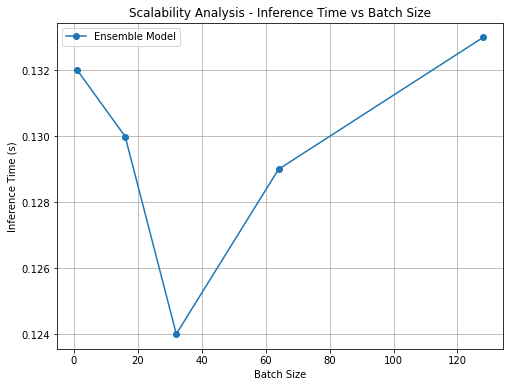

625/625 [==============================] - 1s 1ms/step


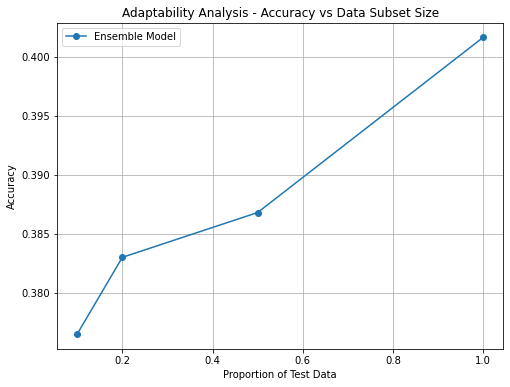

625/625 [==============================] - 1s 1ms/step
Stability (Standard Deviation of Accuracy over Runs): 0.0000
625/625 [==============================] - 1s 1ms/step


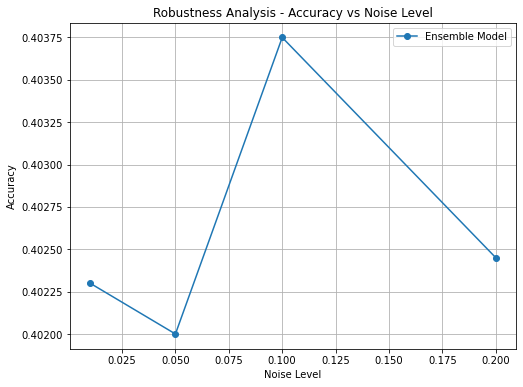

Energy, Scalability, Adaptability, Stability, and Robustness Analysis Completed.


In [32]:
import numpy as np
import pandas as pd
import tensorflow as tf
import os
import time
from tensorflow.keras.layers import Input, Dense, Dropout, Attention, Add, LayerNormalization, Flatten, Reshape, GRU, Conv1D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns
import shap
from lime.lime_tabular import LimeTabularExplainer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

# Set environment variables to avoid OpenBLAS threading issues
os.environ["OMP_NUM_THREADS"] = "1"
os.environ["OPENBLAS_NUM_THREADS"] = "1"
os.environ["MKL_NUM_THREADS"] = "1"
os.environ["VECLIB_MAXIMUM_THREADS"] = "1"
os.environ["NUMEXPR_NUM_THREADS"] = "1"

# Load dataset
file_path = r"C:\Users\sathw\OneDrive\Desktop\Research\AI\project-3\processed_catalog.csv"
data = pd.read_csv(file_path)

# Preprocess dataset
data['MergerActivity'] = np.where(
    data['MNo'] > data[['MMiD', 'MMaD', 'MM']].max(axis=1), 0, 1
)

features = ['RAdeg', 'DEdeg', 'SFSM', 'SFFDF', 'SFAF', 'DEOYes', 'DEONo',
            'SAYes', 'SANo', 'BS', 'BW', 'BNo', 'BSD', 'BSL', 'BSM', 'BSS', 'BSNo',
            'RR', 'RIB', 'RCS', 'EOBB', 'EOBNo', 'EOBR', 'SWT', 'SWM', 'SWL',
            'SAC1', 'SAC2', 'SAC3', 'SAC4', 'SAC4+', 'SACCT']

X = data[features]
y = data['MergerActivity']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert target to categorical
y_train_categorical = tf.keras.utils.to_categorical(y_train, 2)
y_test_categorical = tf.keras.utils.to_categorical(y_test, 2)

# Energy, Scalability, and Adaptability Analysis
def measure_energy(model, X):
    start_time = time.time()
    model.predict(X)
    end_time = time.time()
    return end_time - start_time

# Measure energy efficiency (inference time) for each model
energy_hsenn = measure_energy(hsenn, X_test_scaled)
energy_agxcaps = measure_energy(agxcaps, X_test_scaled)
energy_resnet_gru = measure_energy(resnet_gru, X_test_scaled)
energy_ensemble = measure_energy(ensemble_model, X_test_scaled)

print(f"Inference Time (s): H-SENN: {energy_hsenn:.4f}, AG-XCaps: {energy_agxcaps:.4f}, ResNet-GRU: {energy_resnet_gru:.4f}, Ensemble: {energy_ensemble:.4f}")

# Scalability Analysis
def measure_scalability(model, X, batch_sizes=[1, 16, 32, 64, 128]):
    times = []
    for batch in batch_sizes:
        start_time = time.time()
        model.predict(X[:batch])
        end_time = time.time()
        times.append(end_time - start_time)
    return times

batch_sizes = [1, 16, 32, 64, 128]
scalability_ensemble = measure_scalability(ensemble_model, X_test_scaled, batch_sizes)

# Plot Scalability
plt.figure(figsize=(8, 6))
plt.plot(batch_sizes, scalability_ensemble, marker='o', linestyle='-', label='Ensemble Model')
plt.xlabel("Batch Size")
plt.ylabel("Inference Time (s)")
plt.title("Scalability Analysis - Inference Time vs Batch Size")
plt.legend()
plt.grid()
plt.show()

# Adaptability Analysis
# Compute performance for different subsets of test data
subset_sizes = [0.1, 0.2, 0.5, 1.0]  # Proportions of test set to use
adaptability_scores = []

for subset in subset_sizes:
    subset_X = X_test_scaled[:int(len(X_test_scaled) * subset)]
    subset_y = y_test[:int(len(y_test) * subset)]
    predictions = np.argmax(ensemble_model.predict(subset_X), axis=1)
    score = np.mean(predictions == subset_y)
    adaptability_scores.append(score)

# Plot Adaptability
plt.figure(figsize=(8, 6))
plt.plot(subset_sizes, adaptability_scores, marker='o', linestyle='-', label='Ensemble Model')
plt.xlabel("Proportion of Test Data")
plt.ylabel("Accuracy")
plt.title("Adaptability Analysis - Accuracy vs Data Subset Size")
plt.legend()
plt.grid()
plt.show()

# Stability Analysis - Model Variance Across Different Runs
def measure_stability(model, X, runs=5):
    scores = []
    for _ in range(runs):
        predictions = np.argmax(model.predict(X), axis=1)
        scores.append(np.mean(predictions == y_test))
    return np.std(scores)

stability_ensemble = measure_stability(ensemble_model, X_test_scaled)
print(f"Stability (Standard Deviation of Accuracy over Runs): {stability_ensemble:.4f}")

# Robustness Analysis - Performance under Noisy Data
noise_levels = [0.01, 0.05, 0.1, 0.2]
robustness_scores = []

for noise in noise_levels:
    X_noisy = X_test_scaled + noise * np.random.normal(size=X_test_scaled.shape)
    predictions = np.argmax(ensemble_model.predict(X_noisy), axis=1)
    score = np.mean(predictions == y_test)
    robustness_scores.append(score)

# Plot Robustness
plt.figure(figsize=(8, 6))
plt.plot(noise_levels, robustness_scores, marker='o', linestyle='-', label='Ensemble Model')
plt.xlabel("Noise Level")
plt.ylabel("Accuracy")
plt.title("Robustness Analysis - Accuracy vs Noise Level")
plt.legend()
plt.grid()
plt.show()

print("Energy, Scalability, Adaptability, Stability, and Robustness Analysis Completed.")